<a href="https://colab.research.google.com/github/thepbordin/Obstacle-Detection-for-Blind-people/blob/main/YOLOv5_Roboflow_with_my_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Step 1: Install Requirements

In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12262, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (11/11), done.
remote: Total 12262 (delta 2), reused 6 (delta 1), pack-reused 12250
Receiving objects: 100% (12262/12262), 11.96 MiB | 3.34 MiB/s, done.
Resolving deltas: 100% (8488/8488), done.
/content/yolov5
     |████████████████████████████████| 596 kB 37.5 MB/s 
     |████████████████████████████████| 145 kB 40.3 MB/s 
     |████████████████████████████████| 178 kB 67.1 MB/s 
     |████████████████████████████████| 1.1 MB 58.0 MB/s 
     |████████████████████████████████| 67 kB 5.5 MB/s 
     |████████████████████████████████| 54 kB 2.5 MB/s 
     |████████████████████████████████| 138 kB 76.8 MB/s 
     |████████████████████████████████| 62 kB 1.4 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-co

# Step 2: Assemble Our Dataset

In order to train our custom model, we need to assemble a dataset of representative images with bounding box annotations around the objects that we want to detect. And we need our dataset to be in YOLOv5 format.

In Roboflow, you can choose between two paths:

* Convert an existing dataset to YOLOv5 format. Roboflow supports over [30 formats object detection formats](https://roboflow.com/formats) for conversion.
* Upload raw images and annotate them in Roboflow with [Roboflow Annotate](https://docs.roboflow.com/annotate).


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/data"

In [ ]:
import shutil
shutil.rmtree('/content/data')

In [ ]:
!mkdir "/content/data/"
!unzip "/content/drive/Shareddrives/AI Builders/DatasetYOLO/yolo.zip" -d "/content/data/"

Archive:  /content/drive/Shareddrives/AI Builders/DatasetYOLO/yolo.zip
   creating: /content/data/valid/
   creating: /content/data/valid/images/
  inflating: /content/data/valid/images/000c052bb4b882c4.jpg  
  inflating: /content/data/valid/images/000c66e044e850f7.jpg  
  inflating: /content/data/valid/images/000cd0b046e4390b.jpg  
  inflating: /content/data/valid/images/000ceb7c62a21547.jpg  
  inflating: /content/data/valid/images/000cf08de329f81b.jpg  
  inflating: /content/data/valid/images/000d9c77f5749561.jpg  
  inflating: /content/data/valid/images/00d343d4a829121c.jpg  
  inflating: /content/data/valid/images/00d3fcbc86861f4a.jpg  
  inflating: /content/data/valid/images/00d4a6c8831ca56c.jpg  
  inflating: /content/data/valid/images/00d82cf94121d6c1.jpg  
  inflating: /content/data/valid/images/00d8dd6d2ce6fc70.jpg  
  inflating: /content/data/valid/images/00da8827b3288d89.jpg  
  inflating: /content/data/valid/images/00db6b59d3880145.jpg  
  inflating: /content/data/valid/im

# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [ ]:
!pip install wandb

In [ ]:
!python train.py --img 416 --batch 16 --epochs 100 --data /content/data/data.yaml --weights yolov5x.pt --cache

train: weights=yolov5x.pt, cfg=, data=/content/data/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-258-g1156a32 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0

In [ ]:
!zip -r /content/yolov5xDataset2.zip /content/yolov5/runs/train/exp
!cp "/content/yolov5xDataset2.zip" "/content/drive/Shareddrives/Colab Shared Data"

  adding: content/yolov5/runs/train/exp/ (stored 0%)
  adding: content/yolov5/runs/train/exp/train_batch0.jpg (deflated 3%)
  adding: content/yolov5/runs/train/exp/weights/ (stored 0%)
  adding: content/yolov5/runs/train/exp/weights/best.pt (deflated 8%)
  adding: content/yolov5/runs/train/exp/weights/last.pt (deflated 8%)
  adding: content/yolov5/runs/train/exp/events.out.tfevents.1654614189.4831a6ee6860.787.0 (deflated 35%)
  adding: content/yolov5/runs/train/exp/P_curve.png (deflated 5%)
  adding: content/yolov5/runs/train/exp/F1_curve.png (deflated 6%)
  adding: content/yolov5/runs/train/exp/results.csv (deflated 83%)
  adding: content/yolov5/runs/train/exp/val_batch2_pred.jpg (deflated 10%)
  adding: content/yolov5/runs/train/exp/val_batch1_pred.jpg (deflated 8%)
  adding: content/yolov5/runs/train/exp/train_batch2.jpg (deflated 3%)
  adding: content/yolov5/runs/train/exp/train_batch1.jpg (deflated 3%)
  adding: content/yolov5/runs/train/exp/val_batch1_labels.jpg (deflated 9%)
  a

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

## View by tensorboard

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

## Evaluate on Test Set


In [ ]:
!unzip "/content/drive/Shareddrives/Colab Shared Data/yolov5m trained 124 epochs.zip" -d "/content/models/"

In [ ]:
!python val.py --task test --weights /content/models/content/yolov5/runs/train/exp/weights/best.pt --data /content/data/Indoor-Dataset-2-1/data.yaml

val: data=/content/data/Indoor-Dataset-2-1/data.yaml, weights=['/content/models/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-246-g2dd3db0 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model summary: 290 layers, 20889303 parameters, 0 gradients, 48.1 GFLOPs
test: Scanning '/content/data/Indoor-Dataset-2-1/test/labels' images and labels...103 found, 0 missing, 0 empty, 0 corrupt: 100% 103/103 [00:00<00:00, 1716.98it/s]
test: New cache created: /content/data/Indoor-Dataset-2-1/test/labels.cache
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 4/4 [00:04<00:00,  1.15s/it]
                 all        103        450  

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
!python detect.py --weights /content/models/content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/data/test/images

In [ ]:
!unzip "/content/yolov5m pre-trained.zip" -d "/content/data/"

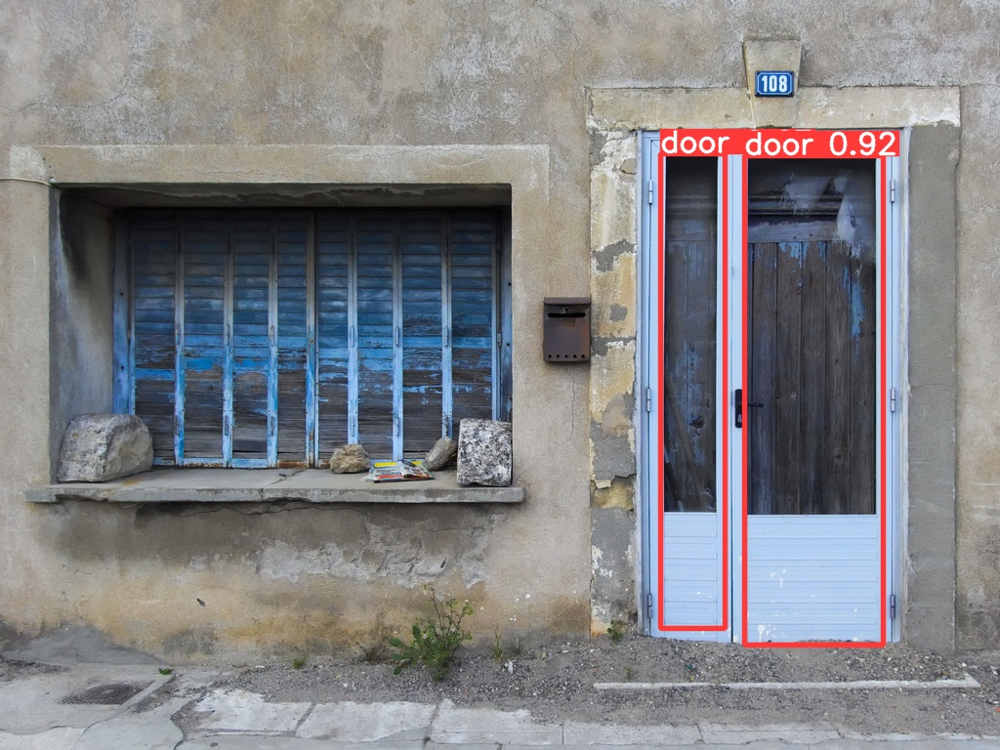

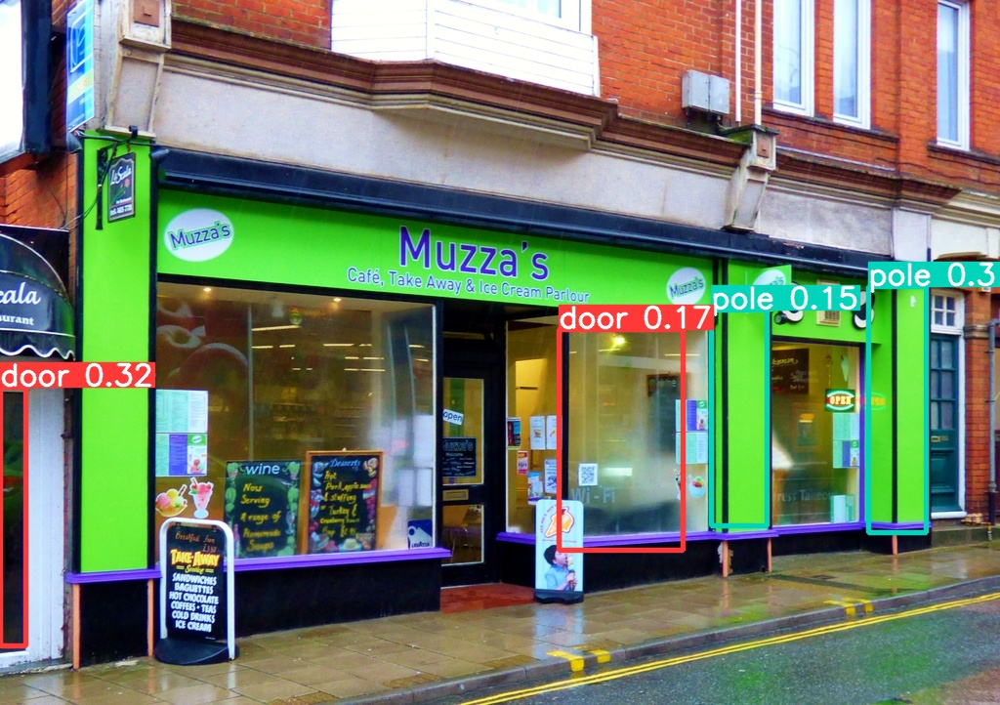

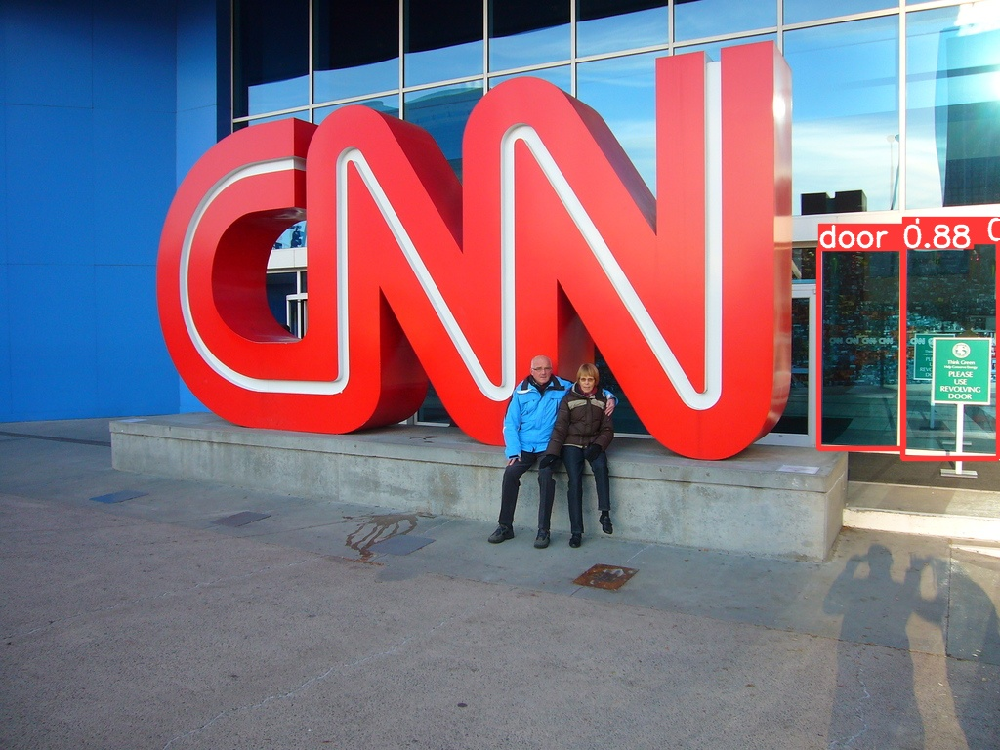

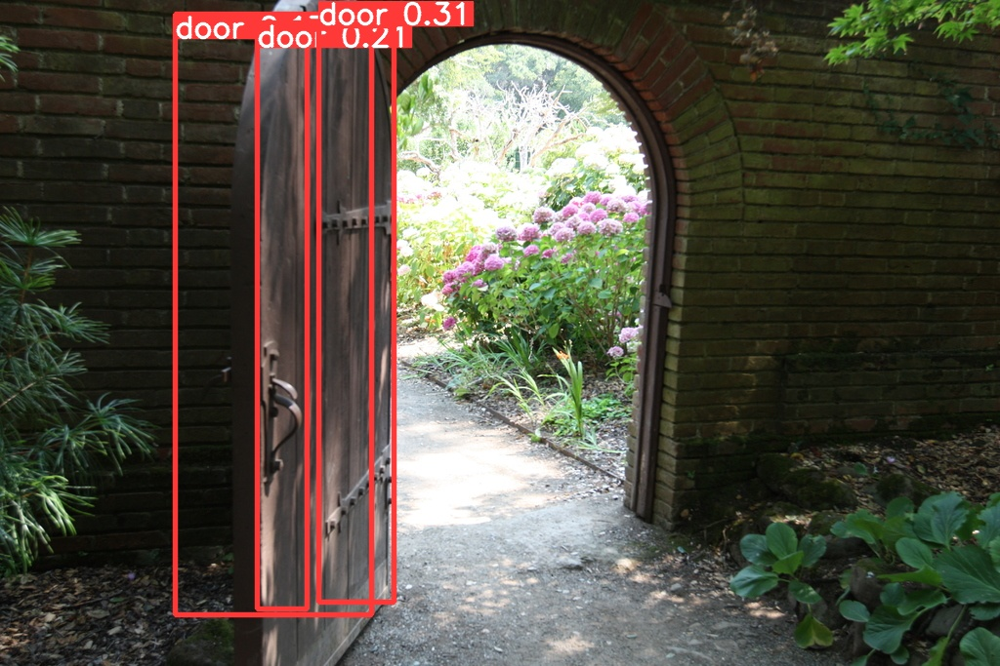

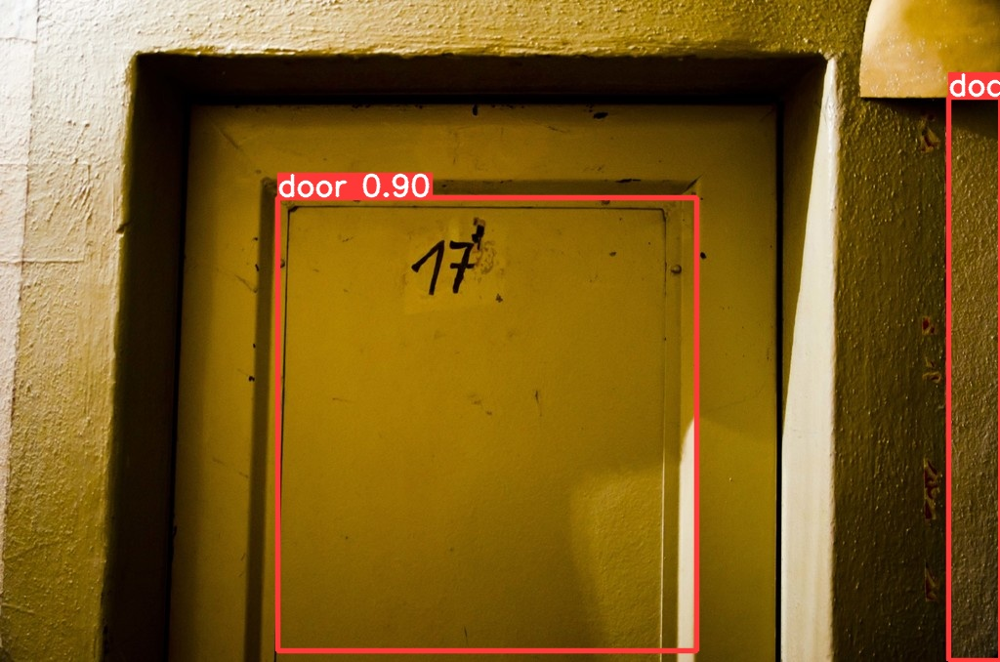

...

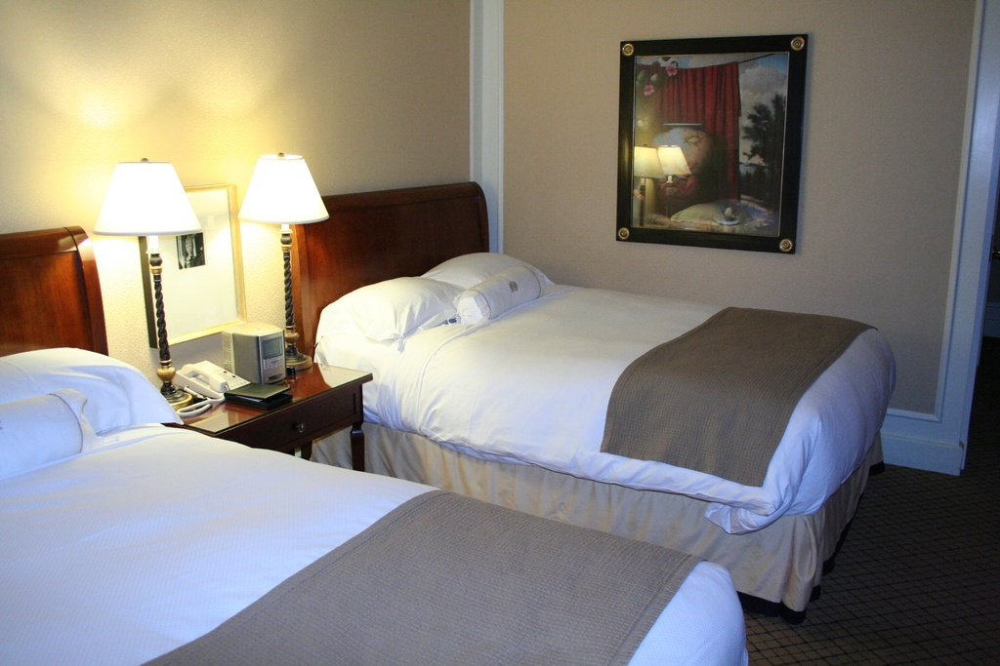

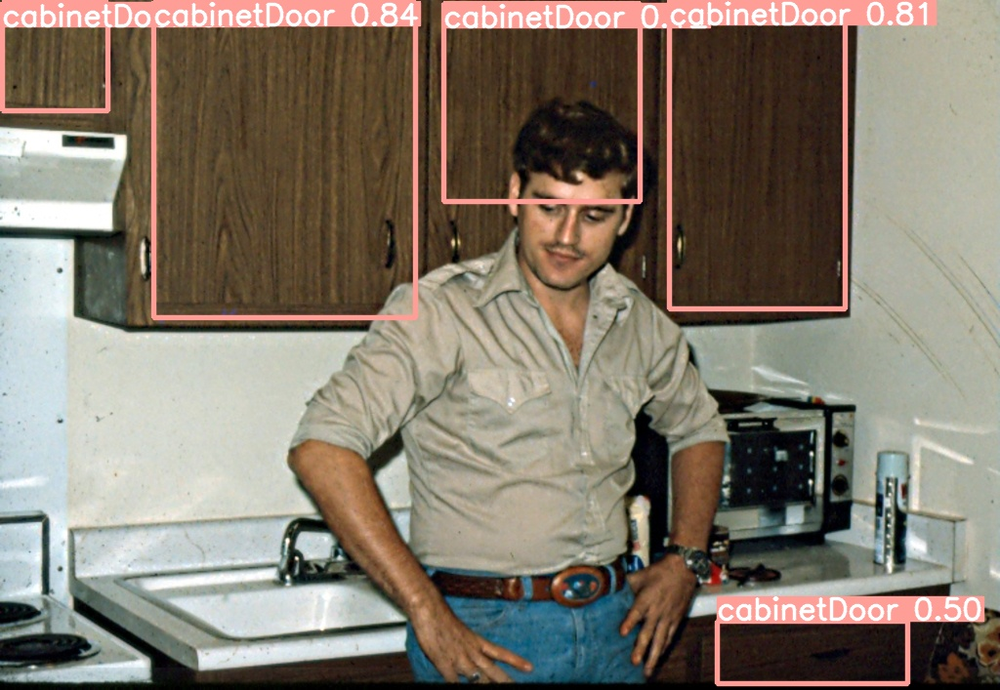

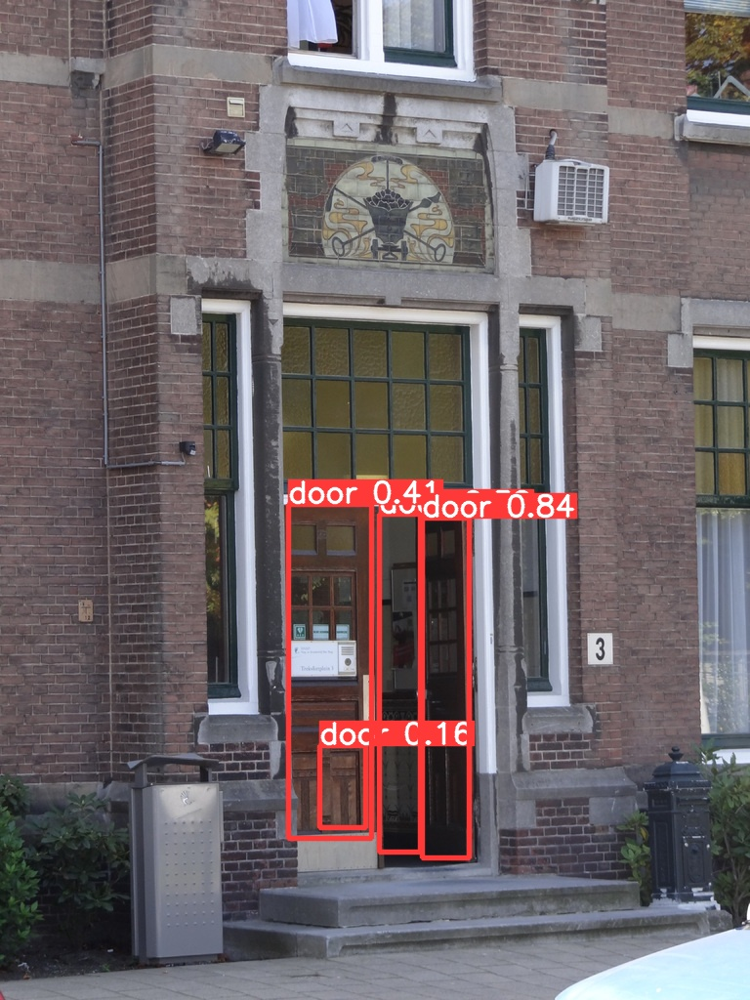

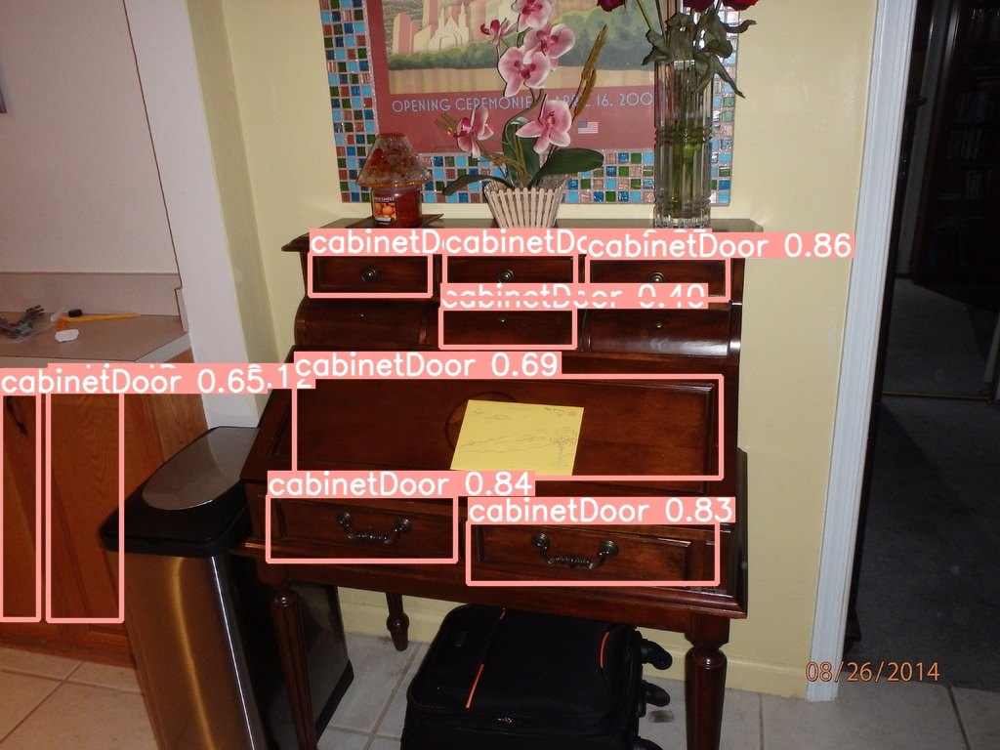

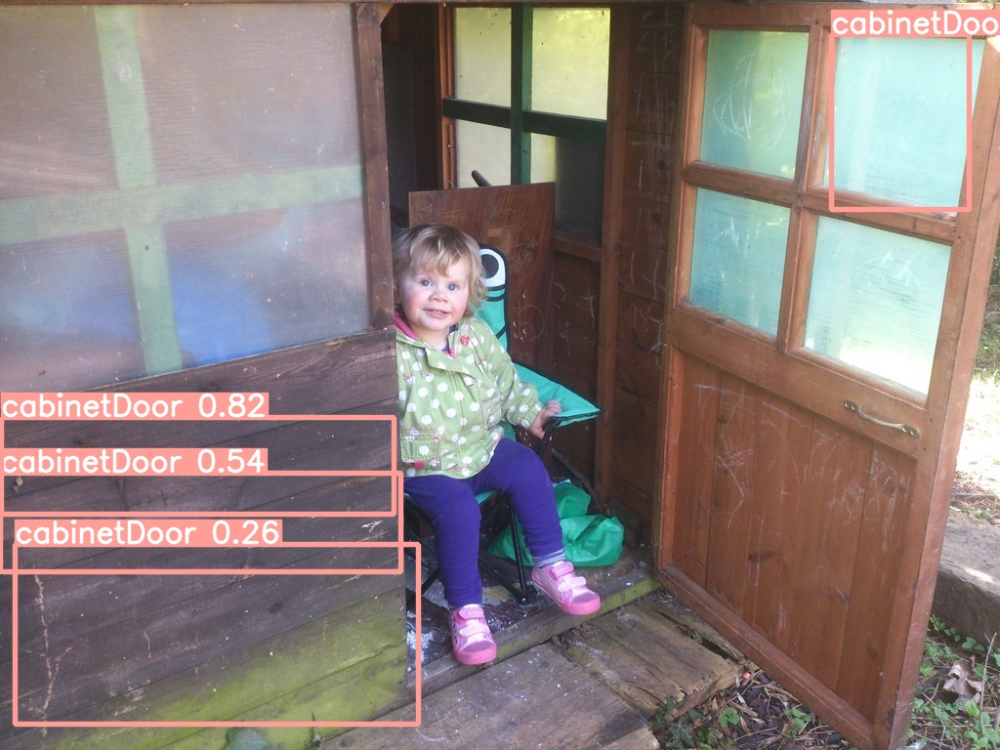

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(imageName))
    print("\n")

In [ ]:
!zip -r /content/yolov5/runs/train/exp.zip /content/yolov5/runs/train/exp